# Question 10

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

import skimage
import skimage.color
import imageio
from IPython.display import display
from PIL import Image
import os

In [3]:
texture_imgnames = ["bois.png", "briques.png", "mur.png", "tissu.png", "nuages.png", "pebbles.jpg"]
#import wget
for fname in texture_imgnames:
  os.system("wget -c https://www.idpoisson.fr/galerne/mva/"+fname)
#   img = Image.open(fname)
#   print(img.size)
#   display(img)

--2022-02-27 12:55:18--  https://www.idpoisson.fr/galerne/mva/bois.png
Résolution de www.idpoisson.fr (www.idpoisson.fr)… 134.206.83.41
Connexion à www.idpoisson.fr (www.idpoisson.fr)|134.206.83.41|:443… connecté.
requête HTTP transmise, en attente de la réponse… 416 Requested Range Not Satisfiable

    Le fichier a déjà été complètement récupéré ; rien à faire.

--2022-02-27 12:55:18--  https://www.idpoisson.fr/galerne/mva/briques.png
Résolution de www.idpoisson.fr (www.idpoisson.fr)… 134.206.83.41
Connexion à www.idpoisson.fr (www.idpoisson.fr)|134.206.83.41|:443… connecté.
requête HTTP transmise, en attente de la réponse… 416 Requested Range Not Satisfiable

    Le fichier a déjà été complètement récupéré ; rien à faire.

--2022-02-27 12:55:18--  https://www.idpoisson.fr/galerne/mva/mur.png
Résolution de www.idpoisson.fr (www.idpoisson.fr)… 134.206.83.41
Connexion à www.idpoisson.fr (www.idpoisson.fr)|134.206.83.41|:443… connecté.
requête HTTP transmise, en attente de la réponse… 41

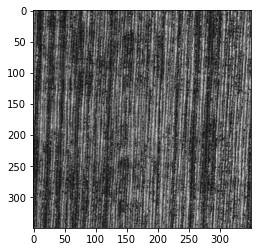

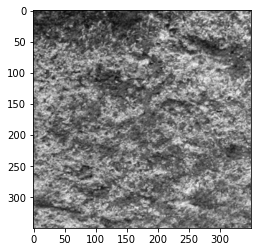

In [5]:
imgrgb = skimage.img_as_float(imageio.imread('tissu.png'))
h0 = skimage.color.rgb2gray(imgrgb)[:350,:350]

imgrgb = skimage.img_as_float(imageio.imread('mur.png'))
h1 = skimage.color.rgb2gray(imgrgb)[:350,:350]

plt.imshow(h0, cmap='gray')
plt.show()
plt.imshow(h1, cmap='gray')
plt.show()

In [6]:
def convolve(im1,im2):
    M,N = im1.shape
    ft1 = np.fft.fft2(im1)
    ft2 = np.fft.fft2(im2)
    return np.fft.ifft2(ft1*ft2*M*N).real

def SNDA(t, rand=None):
    M,N = t.shape
    if rand is None:
        rand = np.random.randn(M,N)
    return convolve(t, rand)

def texton(im):
    ft = np.fft.fft2(im)
    return np.fft.ifft2(np.abs(ft)).real

def adsn_mixing(h0, h1, rho, rand=None):
    if h0.shape != h1.shape:
        print("IMAGES MUST SHARE SHAPE")
        return 
    M,N = h0.shape
    m0 = h0.mean()
    m1 = h1.mean()

    t0 = texton(1/np.sqrt(M*N) * (h0-m0))
    t1 = texton(1/np.sqrt(M*N) * (h1-m1))
    return (1-rho)*m0 + rho*m1 + SNDA((1-rho)*t0 + rho*t1, rand)


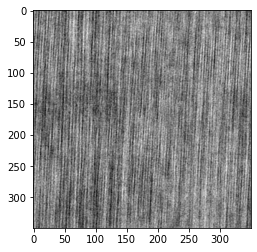

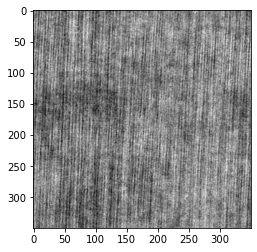

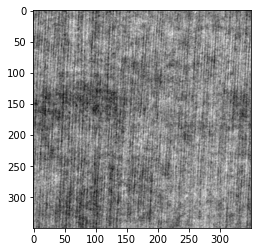

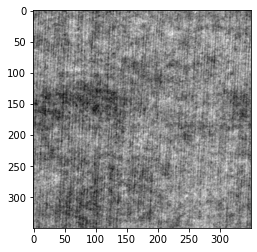

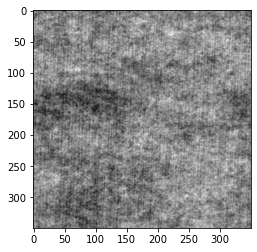

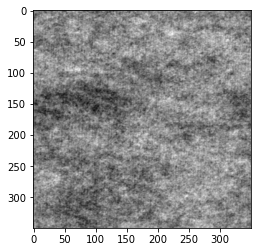

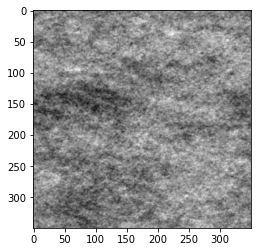

In [8]:
M,N = h0.shape
rand = np.random.randn(M,N)

for rho,i in zip(np.linspace(0,1,7), range(7)):
    mix = adsn_mixing(h0,h1,rho, rand)
    plt.imshow(mix, cmap='gray')
    # plt.imsave('out/mix_'+str(i)+'.png', mix, cmap='gray')
    plt.show()

# Question 11

In [ ]:
import torch
import torch.optim as optim
import torch.nn as nn
from torch.nn.functional import mse_loss
import torchvision.models as models
from torchvision.transforms.functional import resize, to_tensor, normalize, to_pil_image
import numpy as np


from PIL import Image
import matplotlib.pyplot as plt
from io import BytesIO
from urllib.request import urlopen
import os

texture_imgnames = ["bois.png", "briques.png", "mur.png", "tissu.png", "nuages.png","pebbles.jpg","wall1003.png"]
#import wget
for fname in texture_imgnames:
  os.system("wget -c https://www.idpoisson.fr/galerne/mva/"+fname)
  img = Image.open(fname)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print("Device is", device)
!nvidia-smi


Device is cuda:0
Fri Feb 25 19:22:23 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   45C    P8    11W /  70W |      3MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                       

## Prepare data ##

In [ ]:
# Utilities
# Functions to manage images

MEAN = (0.485, 0.456, 0.406)
STD = (0.229, 0.224, 0.225)

def prep_img(imagename: str, size=None, mean=MEAN, std=STD):
    """Preprocess image.
    1) load as PIl
    2) resize
    3) convert to tensor
    4) normalize
    """
    im = Image.open(imagename)
    texture = resize(im, size) # resize so that minimal side length is size pixels
    texture_tensor = to_tensor(texture).unsqueeze(0) # add batch dimension
    # remove alpha channel if any
    if texture_tensor.shape[1]==4:
      print('removing alpha chanel')
      texture_tensor = texture_tensor[:,:3,:,:]
    texture_tensor = normalize(texture_tensor, mean=mean, std=std)
    return texture_tensor


def denormalize(tensor: torch.Tensor, mean=MEAN, std=STD):
    """Based on torchvision.transforms.functional.normalize.
    """
    tensor = tensor.clone().squeeze() # remove batch dimension
    mean = torch.as_tensor(mean, dtype=tensor.dtype, device=tensor.device).view(-1, 1, 1)
    std = torch.as_tensor(std, dtype=tensor.dtype, device=tensor.device).view(-1, 1, 1)
    tensor.mul_(std).add_(mean)
    return tensor


def to_pil(tensor: torch.Tensor):
    """Converts tensor to PIL Image.
    Args: tensor (torch.Temsor): input tensor to be converted to PIL Image of torch.Size([C, H, W]).
    Returns: PIL Image: converted img.
    """
    img = tensor.clone().detach().cpu()
    img = denormalize(img).clip(0, 1)
    img = to_pil_image(img)
    return img

## Model

In [ ]:
cnn = models.vgg19(pretrained=True).features.to(device).eval()
cnn.requires_grad_(False)

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

According to the algorithm explained at the beginning of this notebook, we need to access the outputs of some selected intermediate layers.

In order to access the outputs of the layers on PyTorch VGG19 network, we need to register a hook on each layer we need. Hooks are functions, able to be attached to every layer and called each time the layer is compited. You can register a hook before or after the forward pass, or after the backward pass. We will define a function `save_output` that will be triggered after the forward pass, for each layer of `features` module. 

The outputs of the layers will be stored on a dictionary where the key is the index of the layer and the value is the output tensor of the layer.

So, we must define which layers will be part of the optimization and define weights for each one (we will use the weights when running the texture synthesis). Using the indexes of layers, we select the layers to use in the algorithm. The output of first conv layer, and the outputs of pools layers are a good selection. That's why we choose indexes 0, 4, 9, 18, 27. 

In [ ]:
# Initialize outputs dic
outputs = {}

# Hook definition
def save_output(name):
    
    # The hook signature
    def hook(module, module_in, module_out):
        outputs[name] = module_out
    return hook

# Define layers
layers = [0, 4, 9, 18, 27]
# Define weights for layers
layers_weights = [1e9/n**2 for n in [64,128,256,512,512]]

# Register hook on each layer with index on array "layers"
for layer in layers:
    handle = cnn[layer].register_forward_hook(save_output(layer))

## Frobenius norm

In [ ]:

from torch.autograd import Function
class MatrixSquareRoot(Function):
    """Square root of a positive definite matrix.
    NOTE: matrix square root is not differentiable for matrices with
          zero eigenvalues.
    See Lin, Tsung-Yu, and Subhransu Maji.
        "Improved Bilinear Pooling with CNNs." BMVC 17
    """
    @staticmethod
    def forward(ctx, input):
        dim = input.shape[0]
        norm = torch.norm(input.double())
        Y = input/norm
        I = torch.eye(dim,dim,device=input.device).type(input.dtype)
        Z = torch.eye(dim,dim,device=input.device).type(input.dtype)
        for i in range(15):
            T = 0.5*(3.0*I - Z.mm(Y))
            Y = Y.mm(T)
            Z = T.mm(Z)
        sqrtm = Y*torch.sqrt(norm)
        #ctx.mark_dirty(Y,I,Z)
        ctx.save_for_backward(sqrtm)
        return sqrtm#, I, Y, Z
    @staticmethod
    def backward(ctx, grad_output):
        grad_input = None
        sqrtm, = ctx.saved_tensors
        dim = sqrtm.shape[0]
        norm = torch.norm(sqrtm)
        A = sqrtm/norm
        I = torch.eye(dim, dim, device=sqrtm.device).type(sqrtm.dtype)
        Q = grad_output/norm
        for i in range(15):
            Q = 0.5*(Q.mm(3.0*I-A.mm(A))-A.t().mm(A.t().mm(Q)-Q.mm(A)))
            A = 0.5*A.mm(3.0*I-A.mm(A))
        grad_input = 0.5*Q
        return grad_input
sqrtm = MatrixSquareRoot.apply # call: sqrtm(tensor of size d x d)


def frob(C, Cb):
  Csm = sqrtm(C)
  mat = C + Cb - 2*sqrtm(Csm.matmul(Cb.matmul(Csm)))
  return torch.trace(mat)


## Loss Function and optimizer


In [ ]:
# Computes Gram matrix for the input batch tensor.
#    Args: tnsr (torch.Tensor): input tensor of the Size([B, C, H, W]).
#    Returns:  G (torch.Tensor): output tensor of the Size([B, C, C]).
def gramm(tnsr: torch.Tensor) -> torch.Tensor:   
    b,c,h,w = tnsr.size() 
    F = tnsr.view(b, c, h*w)
    G = torch.bmm(F, F.transpose(1,2)) 
    G.div_(h*w)
    return G

# Computes MSE Loss for 2 Gram matrices 
def gram_loss(input: torch.Tensor, gramm_target: torch.Tensor, weight: float = 1.0):
    loss = weight * mse_loss(gramm(input), gramm_target)
    return loss

def mu_C(tnsr: torch.Tensor) -> torch.Tensor:   
    b,c,h,w = tnsr.size() 
    F = tnsr.view(b, c, h*w)
    mu = F.mean(2)
    Fnorm = F-mu[..., None]
    C = torch.bmm(Fnorm, Fnorm.transpose(1,2)) 
    C.div_(h*w)   
    return mu, C

def dw(tnsr: torch.Tensor, mu_C_target) -> torch.Tensor:   
    mu, C = mu_C(tnsr)
    mu_target, C_target = mu_C_target
    if C.shape[0]!=1:
      print('ERROR IN frob')
    return ((mu-mu_target)**2).sum() + frob(C[0], C_target[0])
    
def custom_Ew(input, mu_C_target, weight):
    return weight * dw(input, mu_C_target)


## Optimizer and initialization:


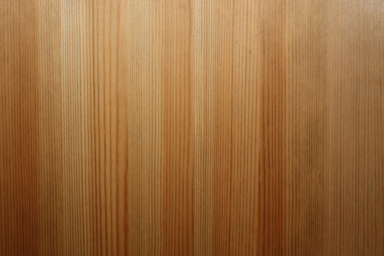

removing alpha chanel


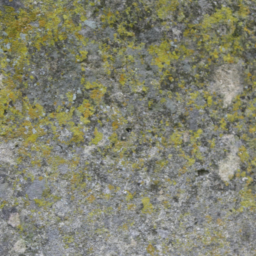

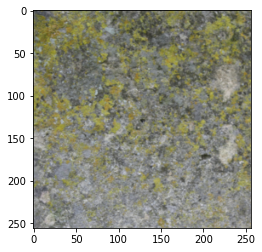

In [ ]:
# selec input image: ["bois.png", "briques.png", "mur.png", "tissu.png", "nuages.png","pebbles.jpg","wall1003.png"]
# Prepare texture data

input_image_name = "bois.png"
img_size = 256
target = prep_img(input_image_name, img_size).to(device)
target_img = to_pil(target)
plt.imshow(target_img)
display(target_img)

input_image_name2 = "wall1003.png"
img_size = 256

# Prepare texture data
target2 = prep_img(input_image_name2, img_size).to(device)
target_img2 = to_pil(target2)
plt.imshow(target_img2)
display(target_img2)


# Forward pass using target texture for get activations of selected layers (outputs). Calculate gram Matrix for those activations
cnn(target)
gramm_targets = [gramm(outputs[key]) for key in layers] 
mu_C_targets = [mu_C(outputs[key]) for key in layers] 

cnn(target2)
gramm_targets2 = [gramm(outputs[key]) for key in layers] 
mu_C_targets2 = [mu_C(outputs[key]) for key in layers] 

rho=0.3


## Running Texture Synthesis


Iteration: 0, loss: 4.49e+07


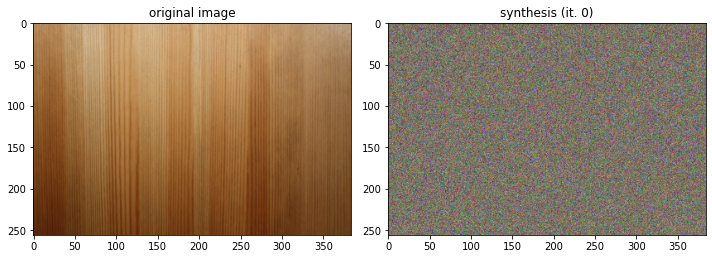

Iteration: 100, loss: 4.05e+05


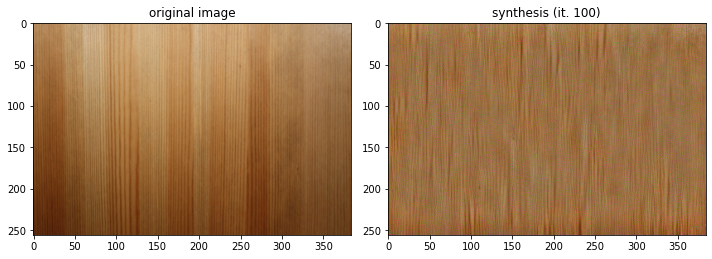

Iteration: 200, loss: 2.42e+05


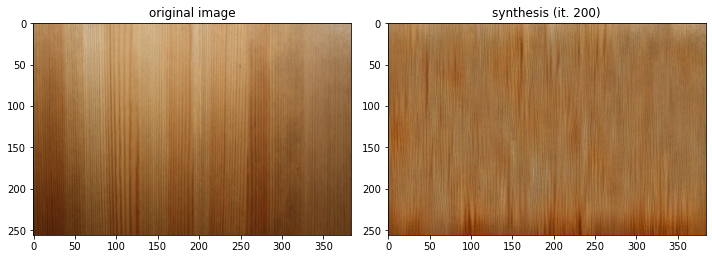

Iteration: 300, loss: 1.93e+05


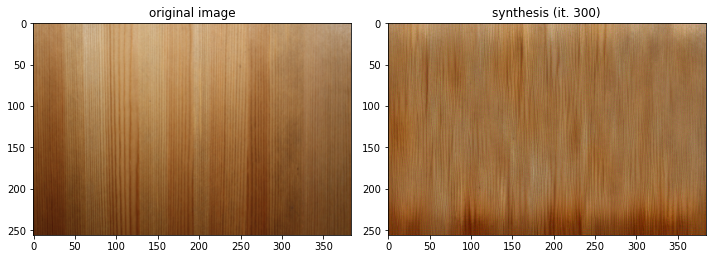

Iteration: 400, loss: 1.72e+05


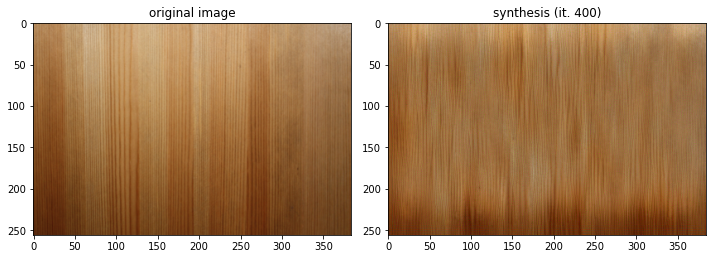

Iteration: 500, loss: 1.62e+05


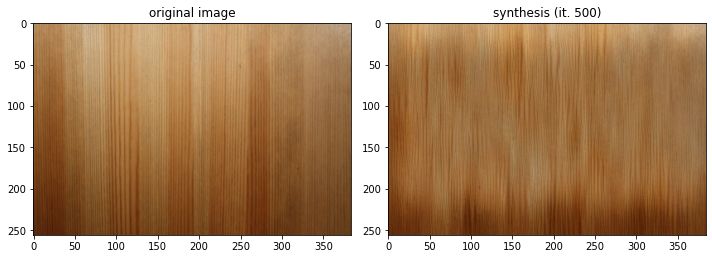

Iteration: 600, loss: 1.56e+05


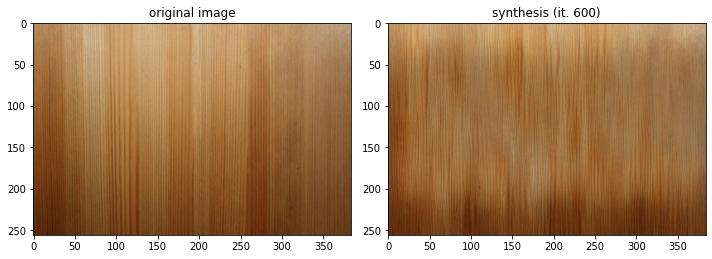

Iteration: 700, loss: 1.53e+05


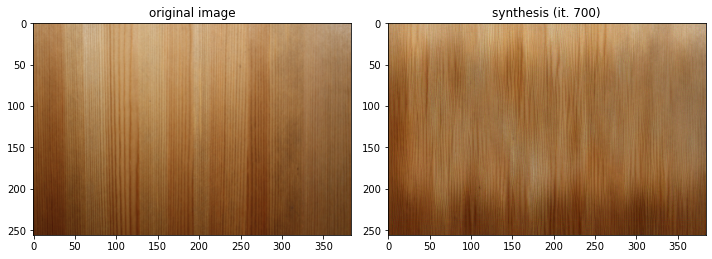

Iteration: 800, loss: 1.52e+05


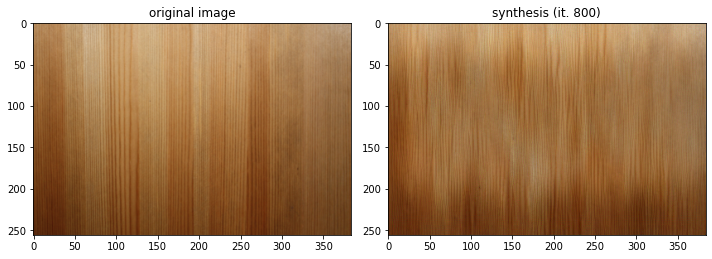

Iteration: 900, loss: 1.51e+05


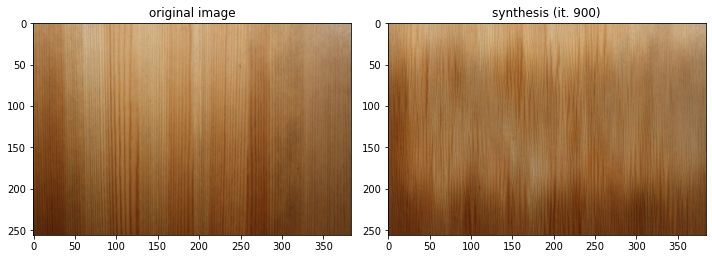

Iteration: 1000, loss: 1.50e+05


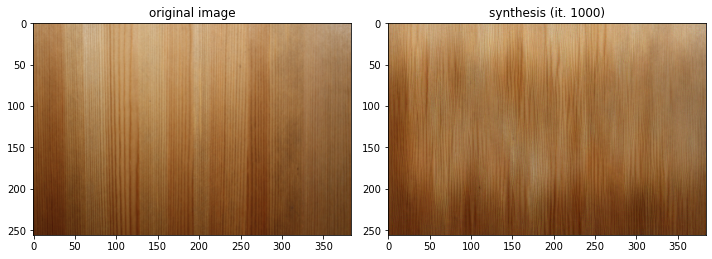

Iteration: 0, loss: 4.10e+07


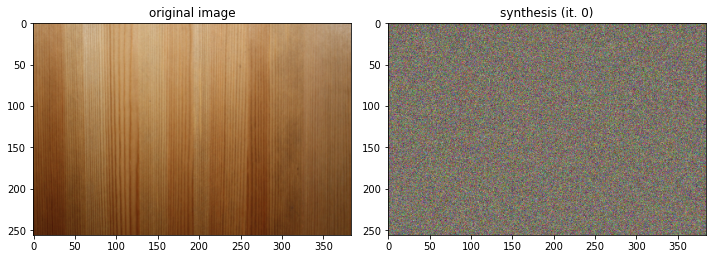

Iteration: 100, loss: 4.95e+06


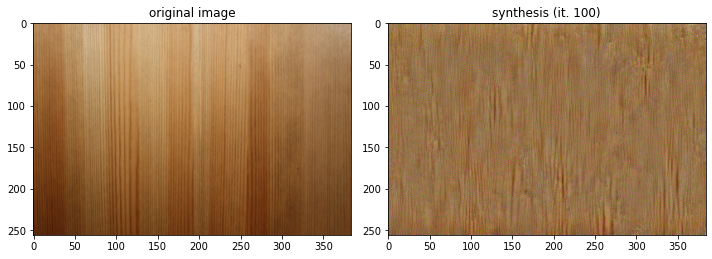

Iteration: 200, loss: 4.83e+06


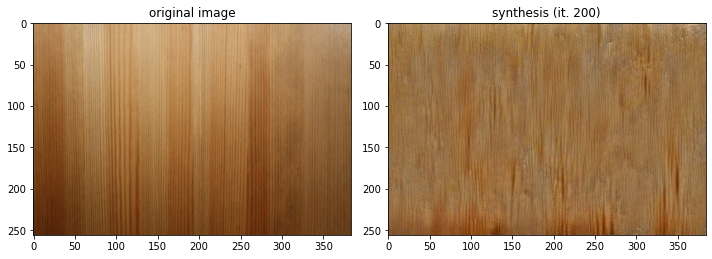

Iteration: 300, loss: 4.79e+06


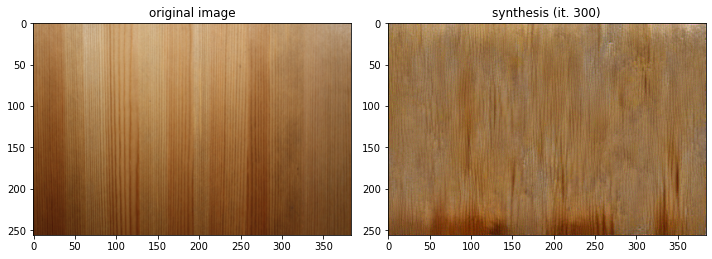

Iteration: 400, loss: 4.77e+06


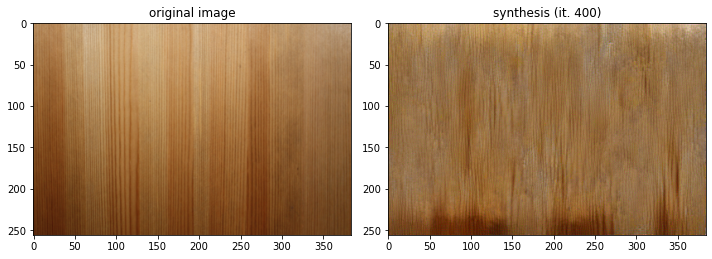

Iteration: 500, loss: 4.76e+06


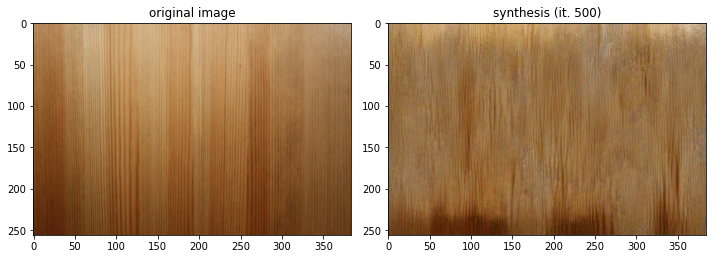

Iteration: 600, loss: 4.76e+06


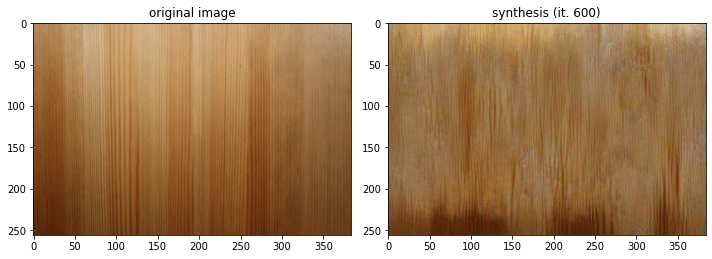

Iteration: 700, loss: 4.75e+06


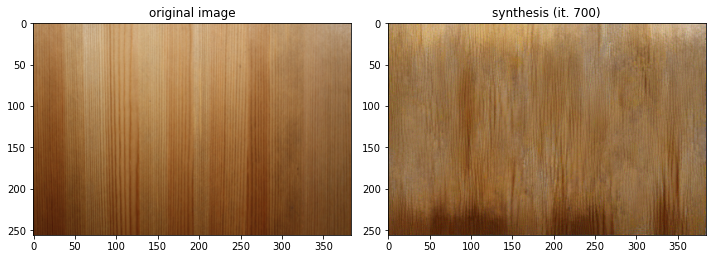

Iteration: 800, loss: 4.75e+06


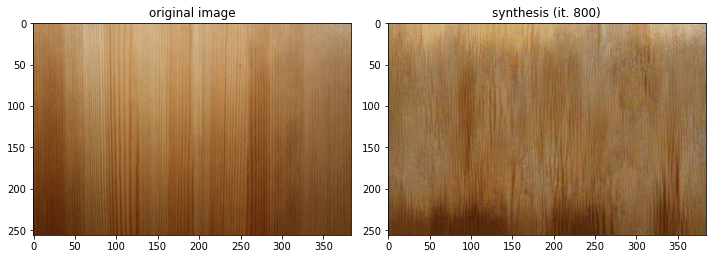

Iteration: 900, loss: 4.75e+06


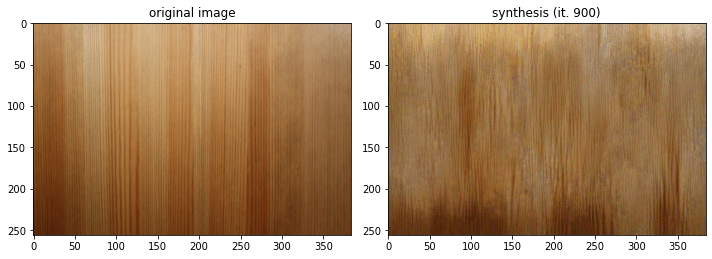

Iteration: 1000, loss: 4.75e+06


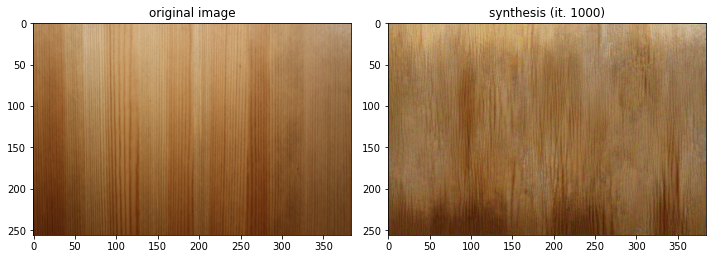

Iteration: 0, loss: 3.74e+07


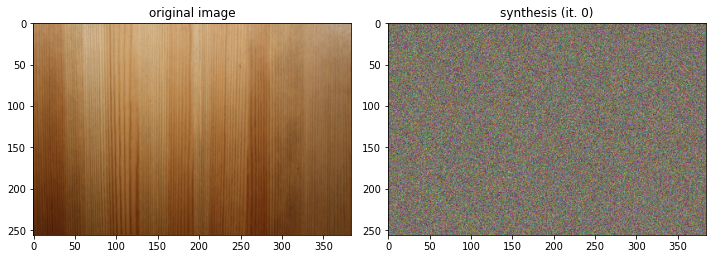

Iteration: 100, loss: 7.76e+06


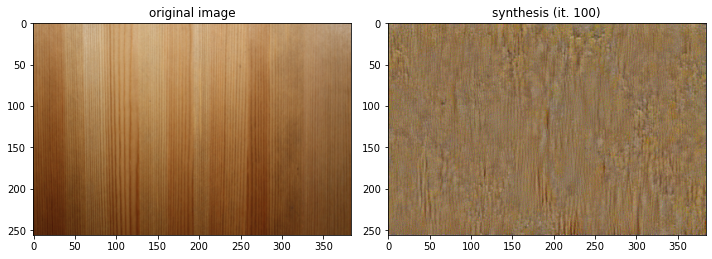

Iteration: 200, loss: 7.67e+06


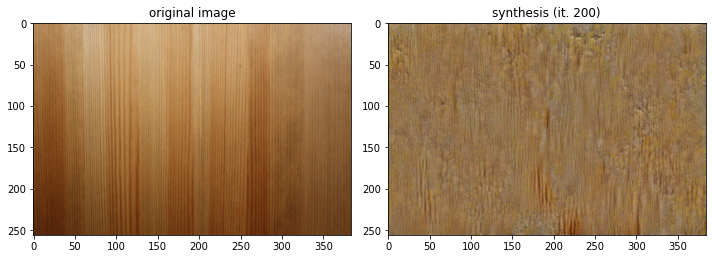

Iteration: 300, loss: 7.64e+06


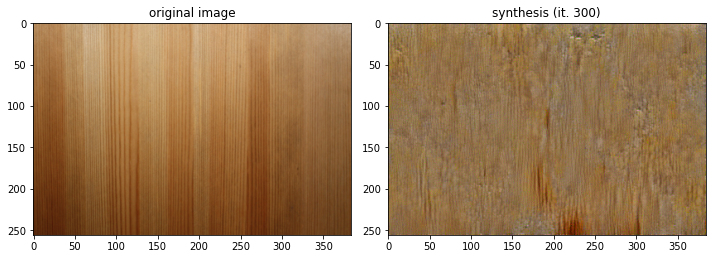

Iteration: 400, loss: 7.62e+06


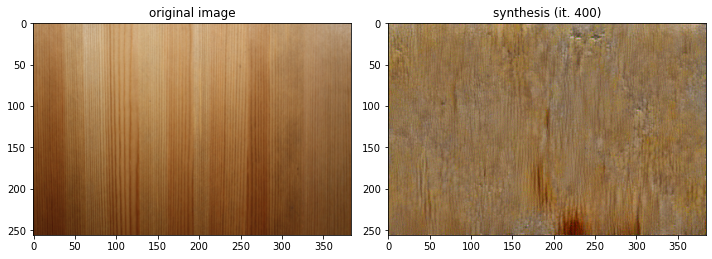

Iteration: 500, loss: 7.61e+06


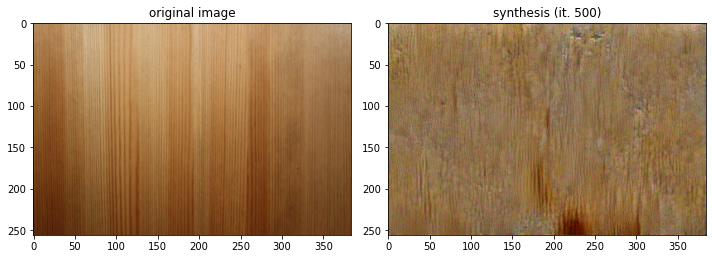

Iteration: 600, loss: 7.60e+06


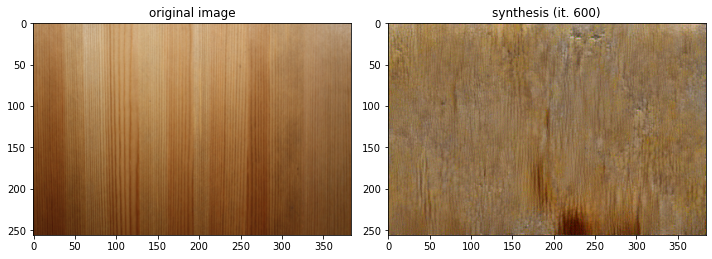

Iteration: 700, loss: 7.60e+06


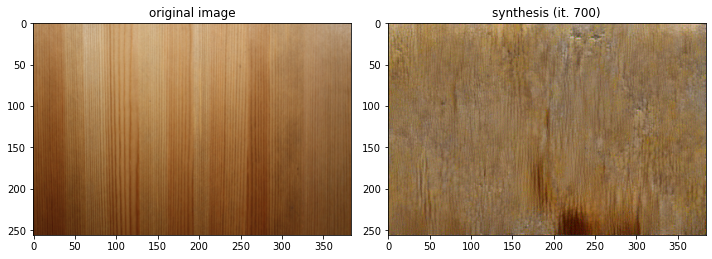

Iteration: 800, loss: 7.59e+06


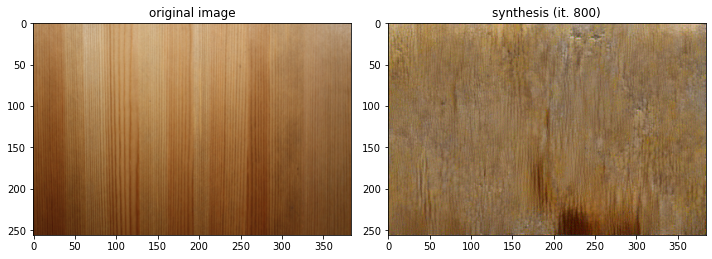

Iteration: 900, loss: 7.59e+06


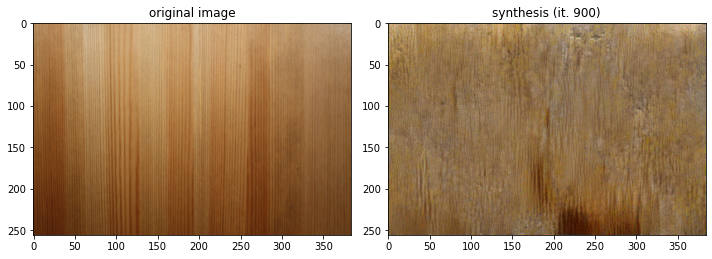

Iteration: 1000, loss: 7.58e+06


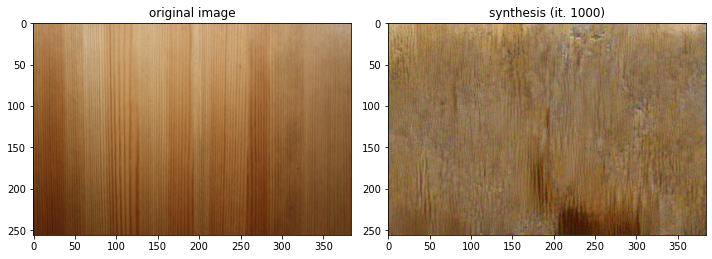

Iteration: 0, loss: 3.36e+07


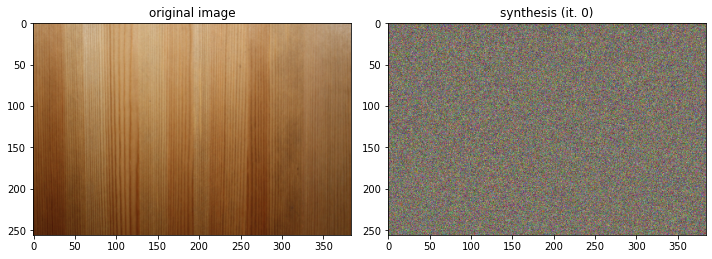

Iteration: 100, loss: 8.65e+06


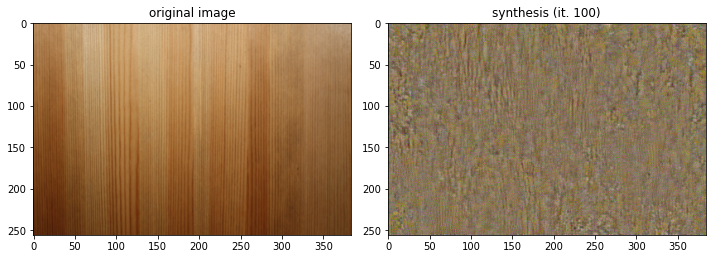

Iteration: 200, loss: 8.56e+06


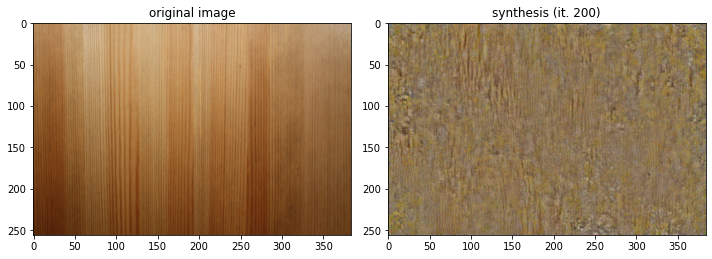

Iteration: 300, loss: 8.54e+06


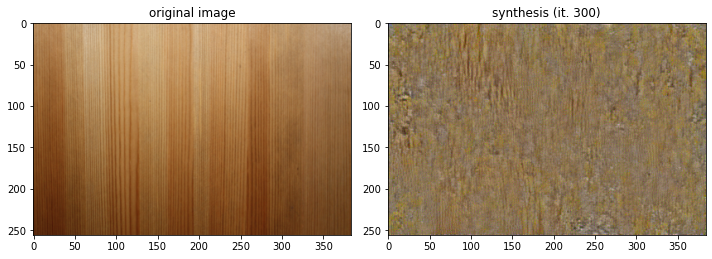

Iteration: 400, loss: 8.53e+06


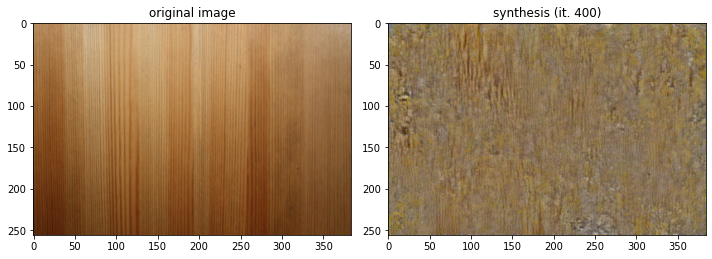

Iteration: 500, loss: 8.53e+06


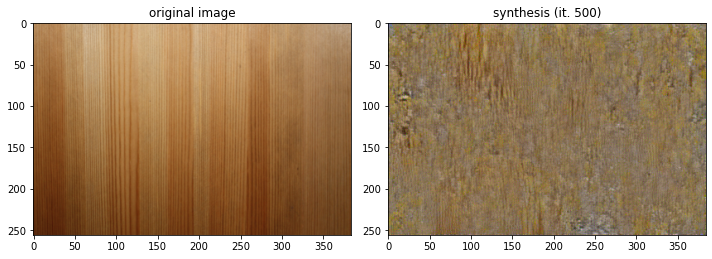

Iteration: 600, loss: 8.52e+06


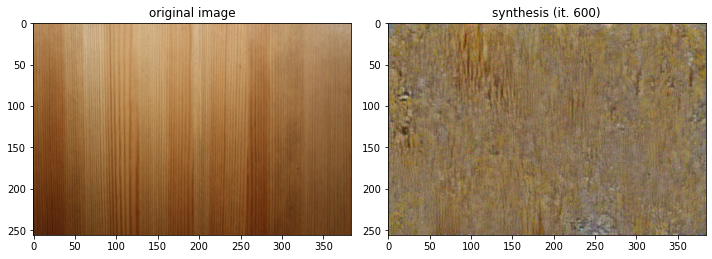

Iteration: 700, loss: 8.52e+06


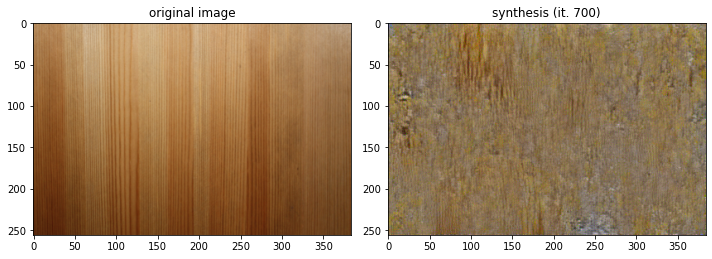

Iteration: 800, loss: 8.51e+06


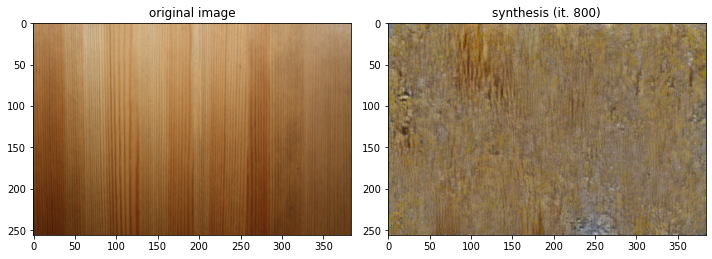

Iteration: 900, loss: 8.51e+06


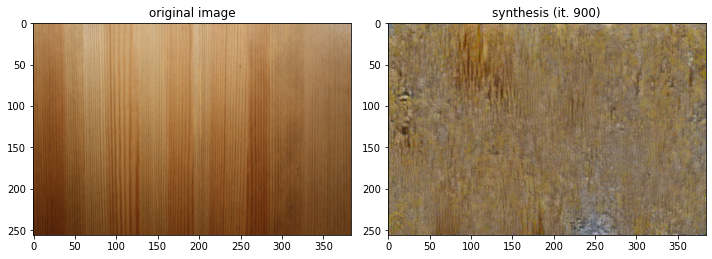

Iteration: 1000, loss: 8.51e+06


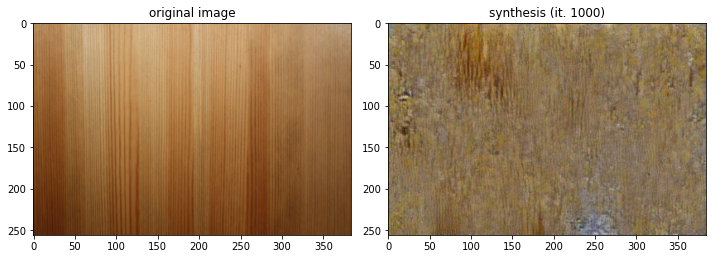

Iteration: 0, loss: 2.97e+07


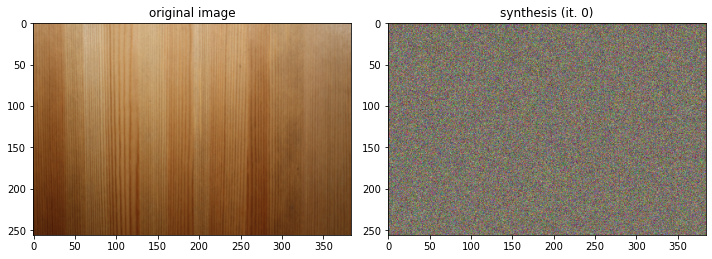

Iteration: 100, loss: 7.63e+06


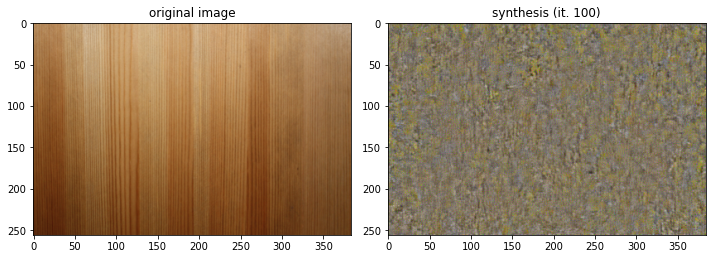

Iteration: 200, loss: 7.56e+06


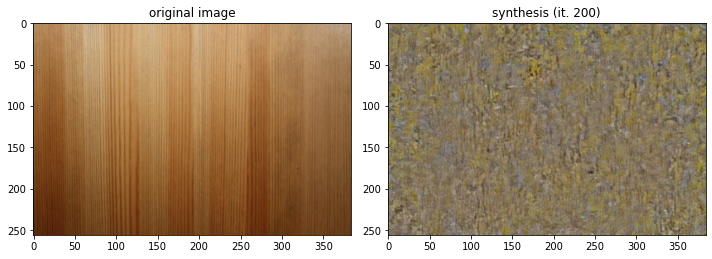

Iteration: 300, loss: 7.54e+06


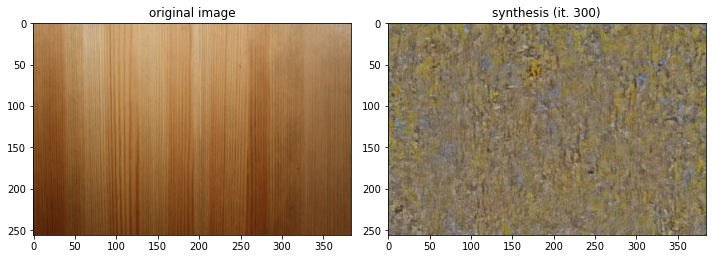

Iteration: 400, loss: 7.53e+06


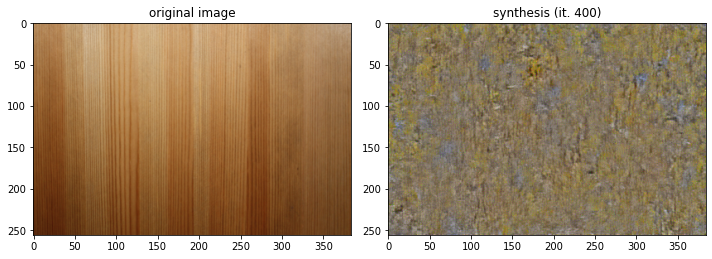

Iteration: 500, loss: 7.52e+06


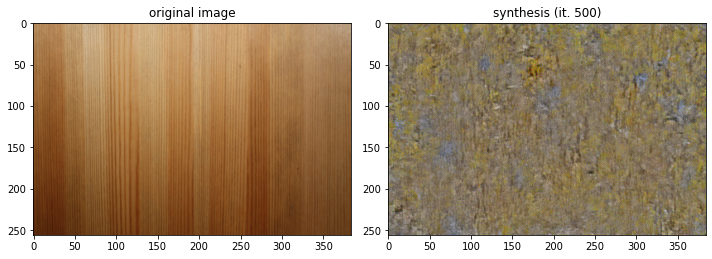

Iteration: 600, loss: 7.52e+06


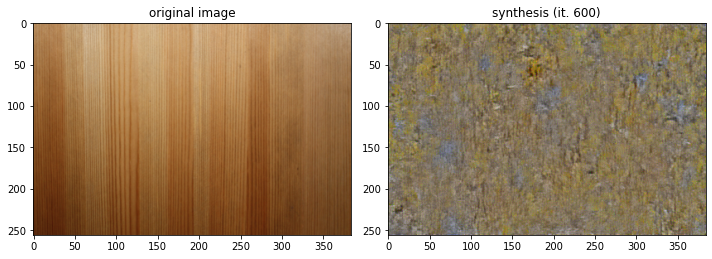

Iteration: 700, loss: 7.52e+06


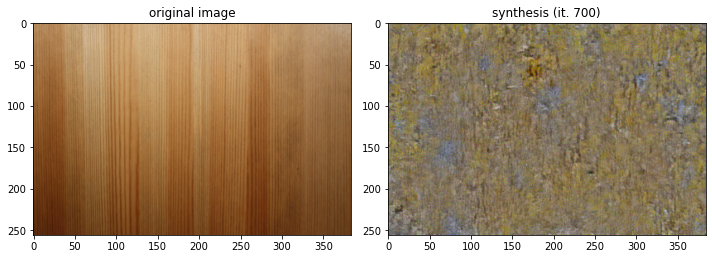

Iteration: 800, loss: 7.52e+06


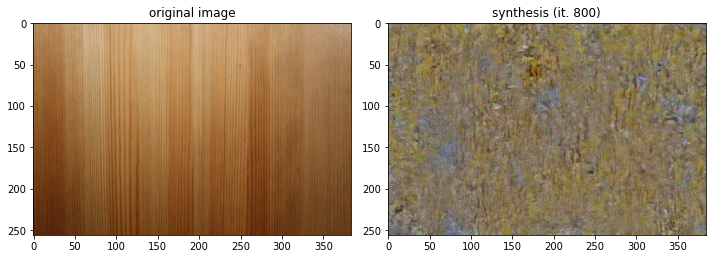

Iteration: 900, loss: 7.51e+06


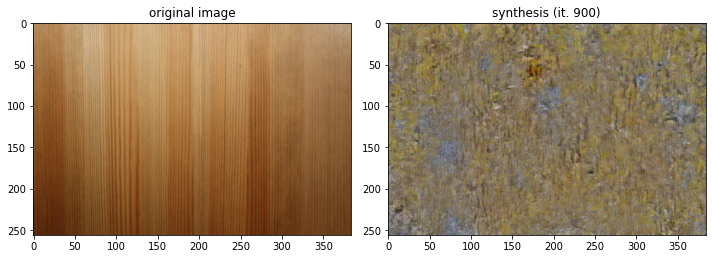

Iteration: 1000, loss: 7.51e+06


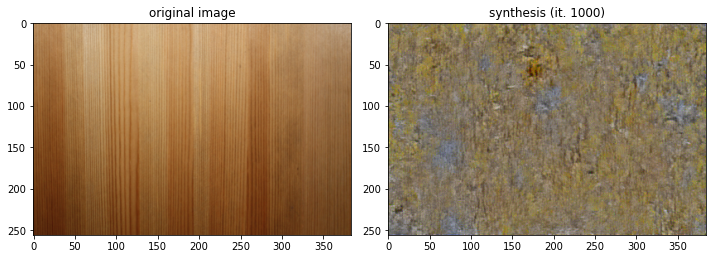

Iteration: 0, loss: 2.63e+07


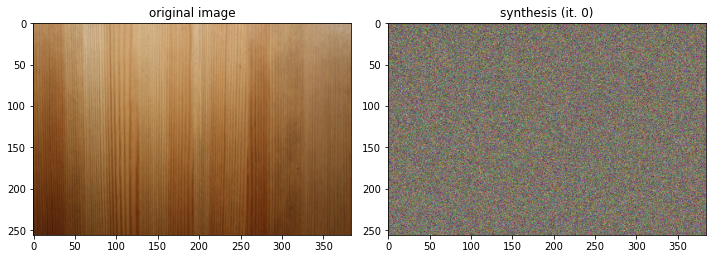

Iteration: 100, loss: 4.79e+06


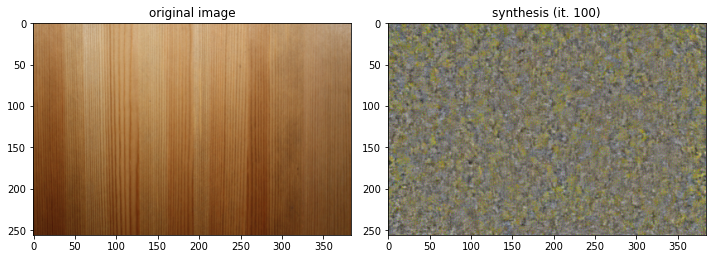

Iteration: 200, loss: 4.74e+06


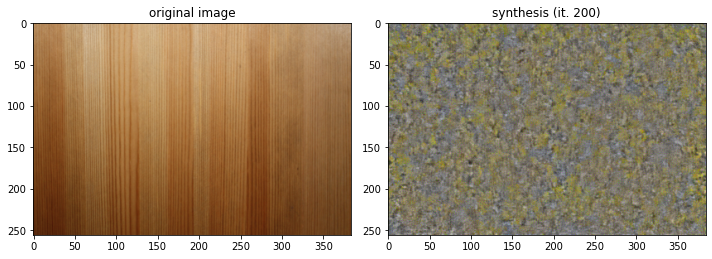

Iteration: 300, loss: 4.73e+06


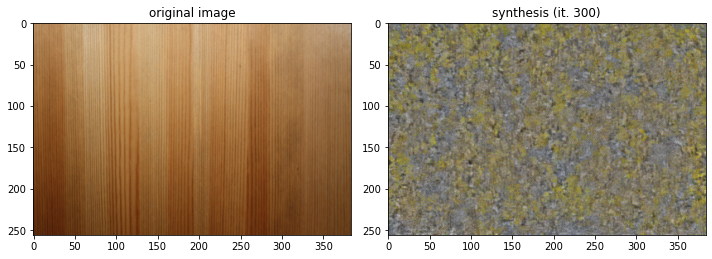

Iteration: 400, loss: 4.72e+06


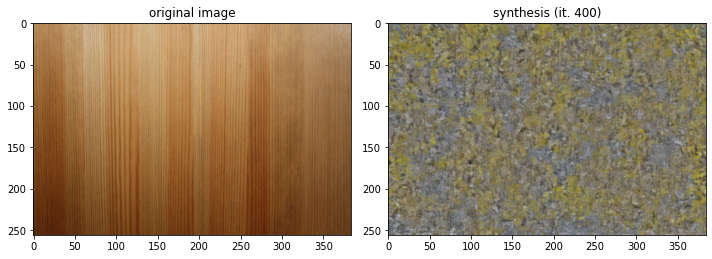

Iteration: 500, loss: 4.72e+06


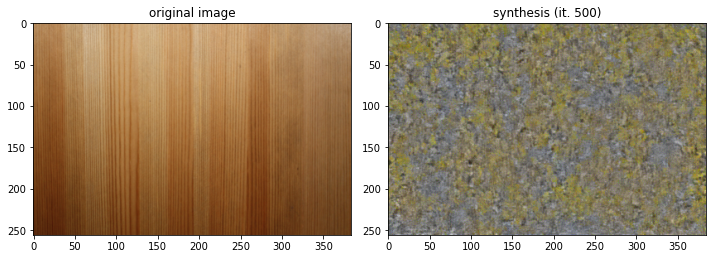

Iteration: 600, loss: 4.72e+06


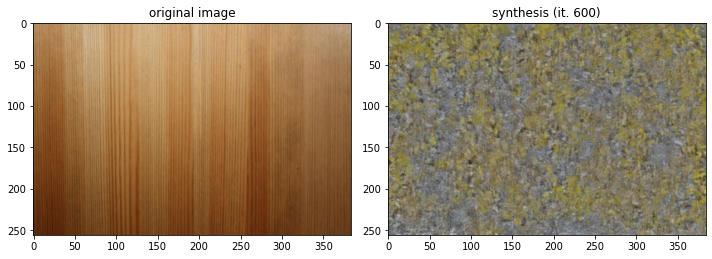

Iteration: 700, loss: 4.72e+06


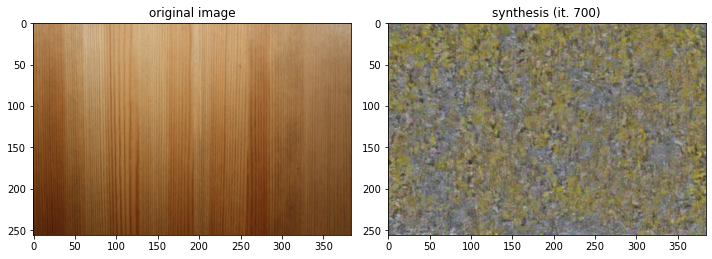

Iteration: 800, loss: 4.72e+06


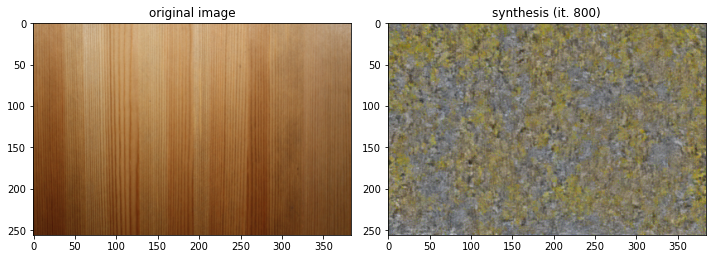

Iteration: 900, loss: 4.71e+06


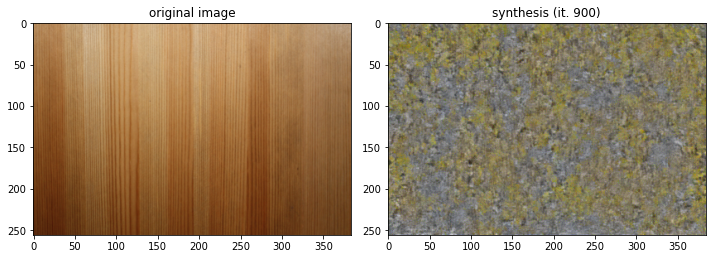

Iteration: 1000, loss: 4.71e+06


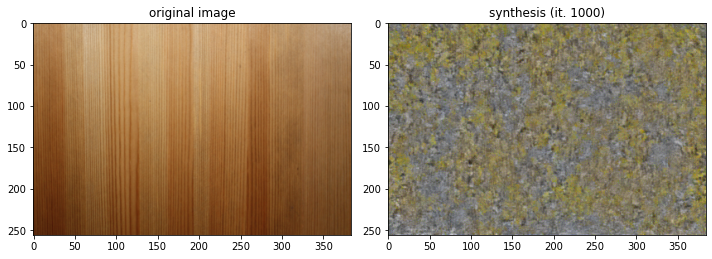

Iteration: 0, loss: 2.28e+07


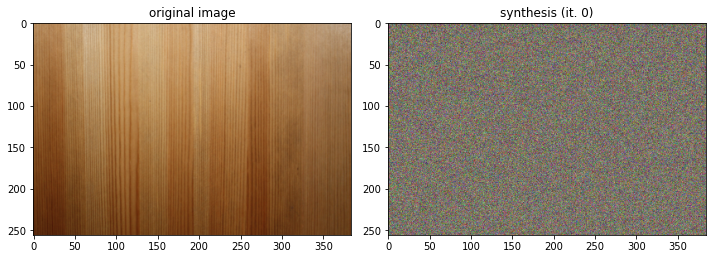

Iteration: 100, loss: 2.41e+05


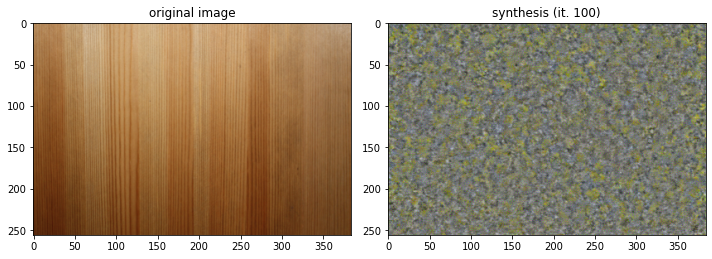

Iteration: 200, loss: 2.01e+05


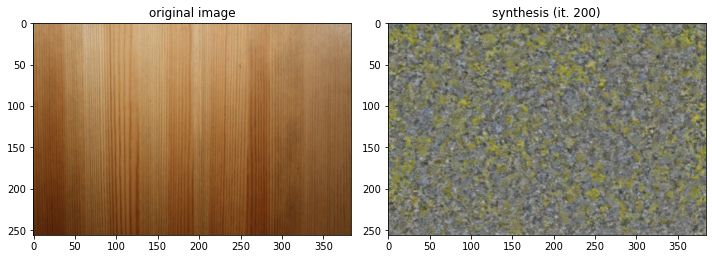

Iteration: 300, loss: 1.90e+05


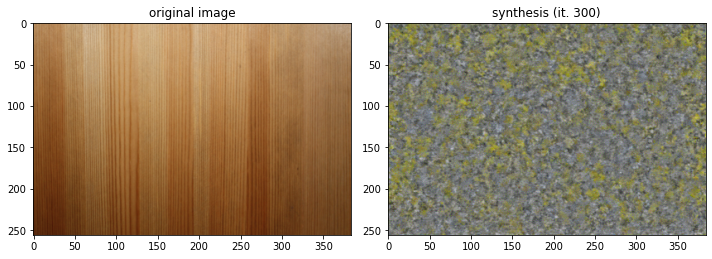

Iteration: 400, loss: 1.86e+05


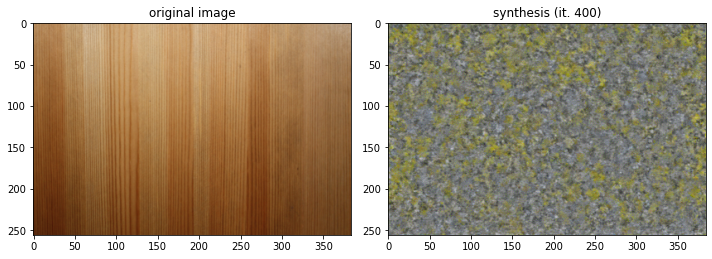

Iteration: 500, loss: 1.83e+05


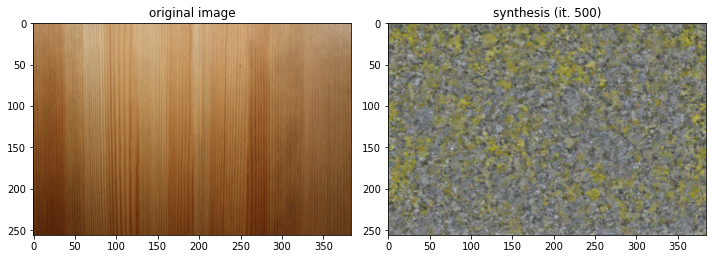

Iteration: 600, loss: 1.81e+05


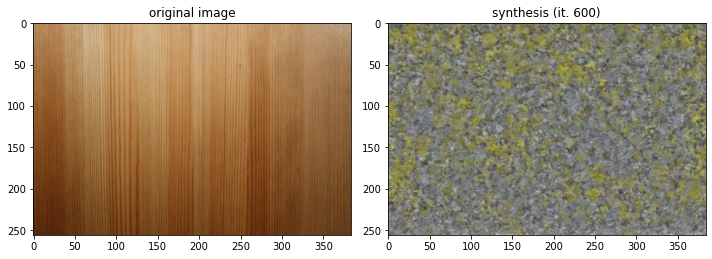

Iteration: 700, loss: 1.80e+05


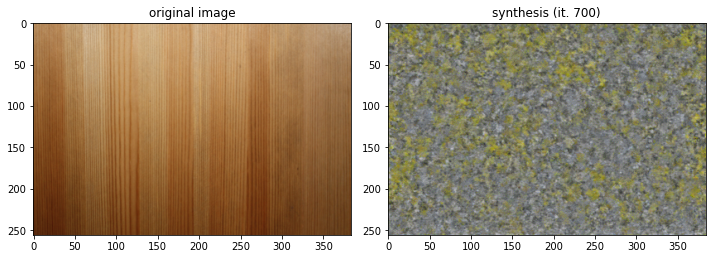

Iteration: 800, loss: 1.79e+05


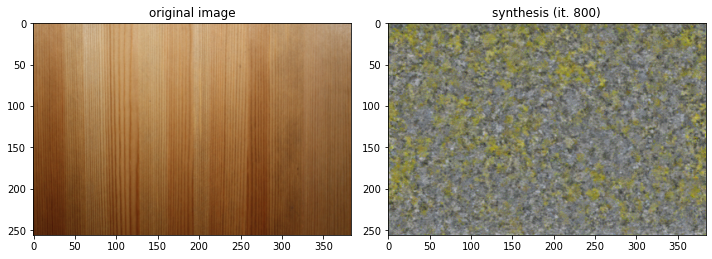

Iteration: 900, loss: 1.78e+05


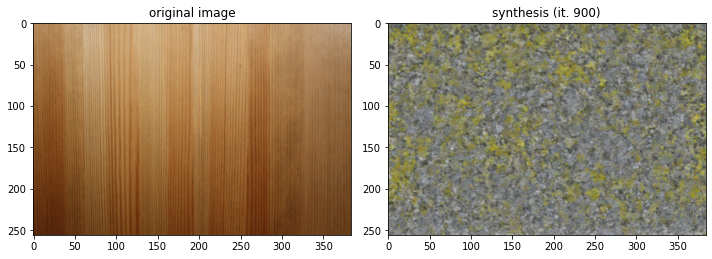

Iteration: 1000, loss: 1.77e+05


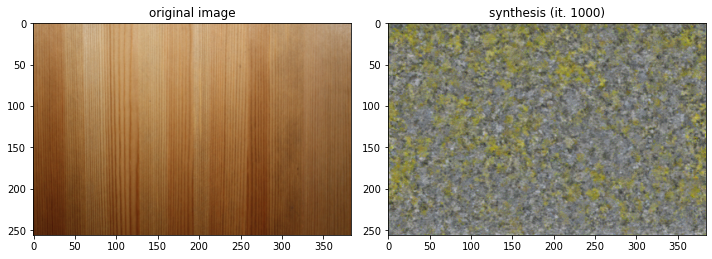

In [ ]:
for rho in np.linspace(0,1,7):
  # Random init for image synth
  synth = torch.randn_like(target) * 0.5
  synth.requires_grad=True

  # Set optimizer
  optimizer = optim.LBFGS([synth])
  n_iters = 1000
  log_every = n_iters//10
  iter_ = 0

  while iter_ <= n_iters:

      def closure():
          global iter_

          optimizer.zero_grad()

          # Forward pass using synth. Get activations of selected layers for image synth (outputs). Calculate gram Matrix for those activations
          cnn(synth)
          synth_outputs = [outputs[key] for key in layers] 
          
          # Compute loss for each activation
          losses1 = []
          losses2 = []
          for activations in zip(synth_outputs, mu_C_targets, layers_weights):
            losses1.append(custom_Ew(*activations).unsqueeze(0))
          for activations in zip(synth_outputs, mu_C_targets2, layers_weights):
            losses2.append(custom_Ew(*activations).unsqueeze(0))
          
          losses = [losses1[i]*(1-rho) + rho* losses2[i] for i in range(len(losses1))]


          total_loss = torch.cat(losses).sum()

          total_loss.backward()

          # Display results: print Loss value and show image
          if iter_ == 0 or iter_ % log_every == 0:
              print('Iteration: %d, loss: %1.2e'%(iter_, total_loss.item()))
              fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 20))
              axes[0].imshow(target_img)
              axes[0].set_title('original image')
              axes[1].imshow(to_pil(synth))
              axes[1].set_title('synthesis (it. %d)'%( iter_ ))
              fig.tight_layout()
              plt.pause(0.05)

          iter_ += 1

          return total_loss

      optimizer.step(closure)
  to_pil(synth).save('mix'+str(rho)+'.png')
